In [1]:
# The following variables should be specified:
# 1) The grid dimension
# 2) The number of agents
# 3) The number of interest-points

/var/folders/2d/gpdgqcw134b9wfyg6g2mfw_40000gn/T/ipykernel_1802/3628556086.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(5, 5))
IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (500, 500) to (512, 512) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


Printed


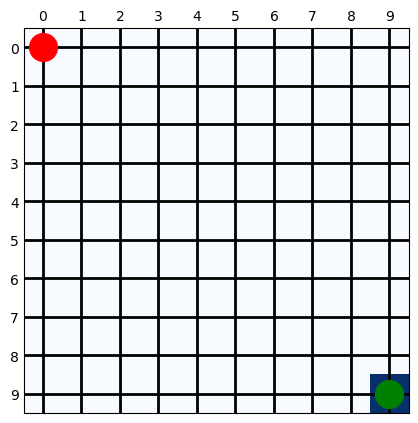

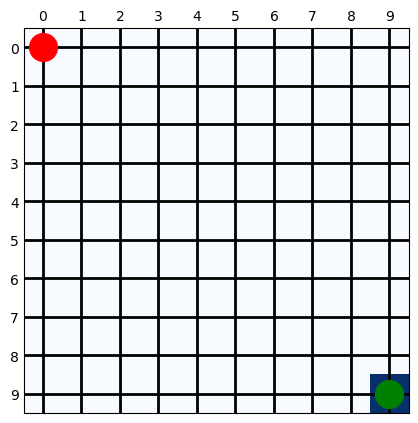

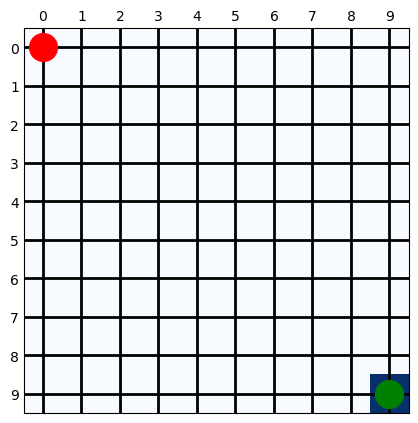

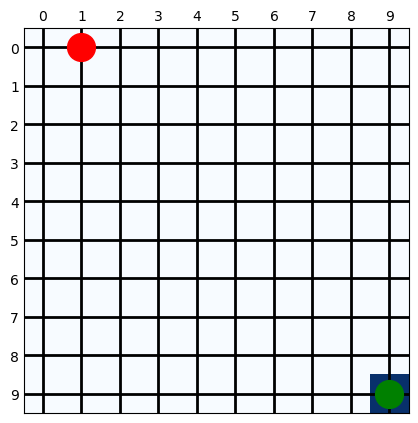

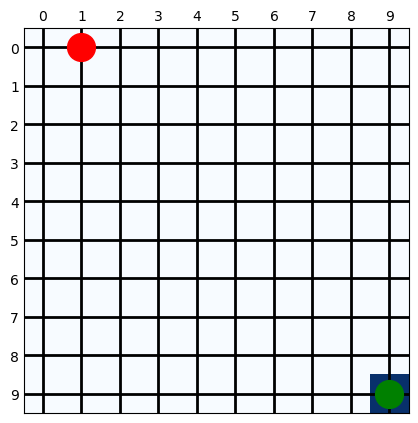

...

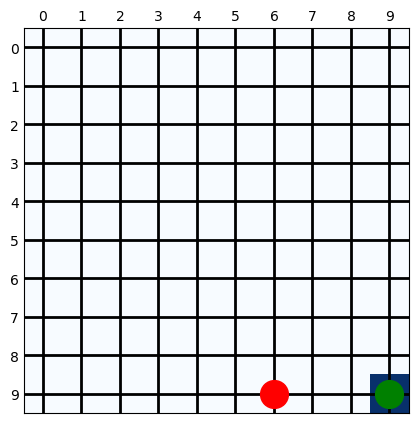

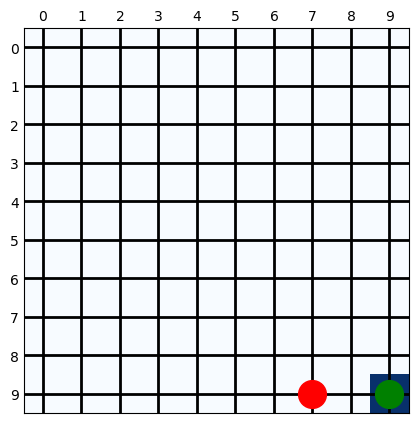

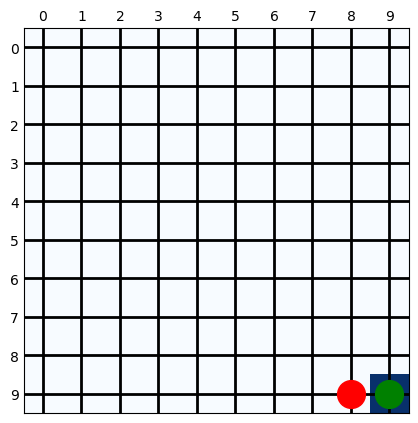

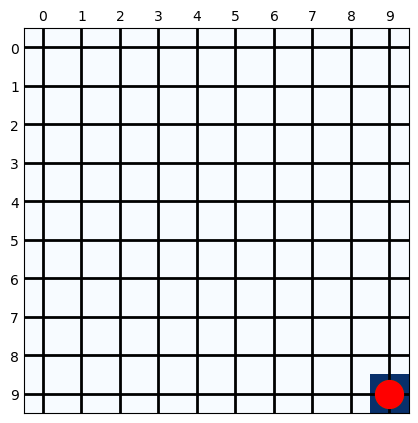

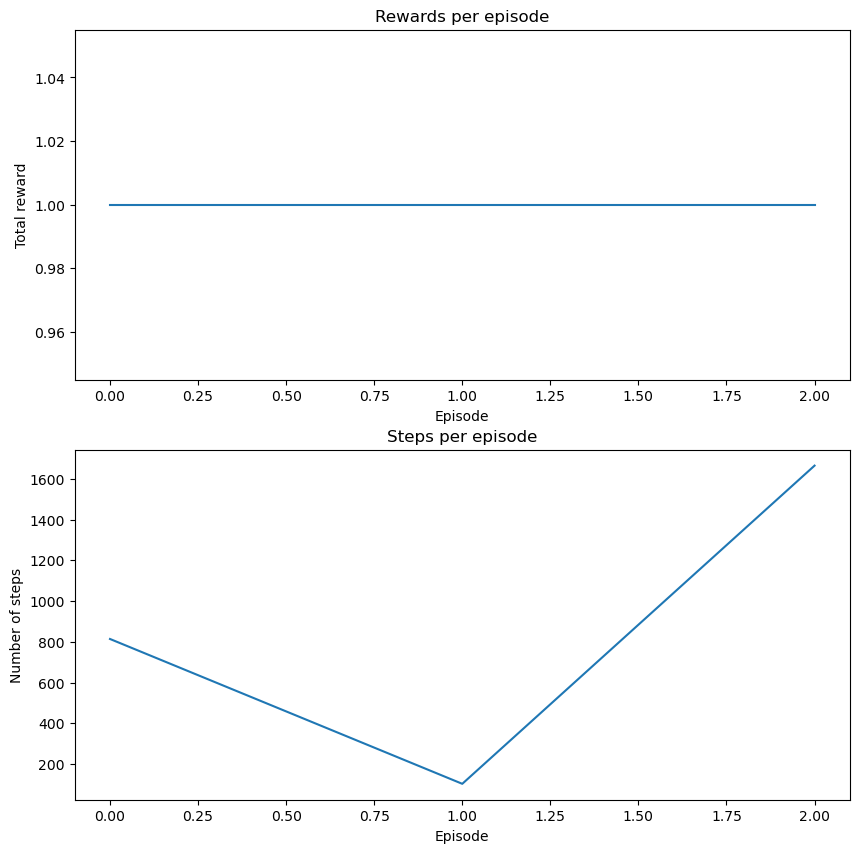

In [27]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation
import imageio

class GridWorld:
    def __init__(self, dim):
        self.dim = dim
        self.agent_pos = (0, 0)
        self.goal_pos = (dim-1, dim-1)
        self.grid = np.zeros((dim, dim))
        self.grid[self.goal_pos] = 1
    
    def step(self, action):
        x, y = self.agent_pos
        if action == 0: # move up
            x = max(x-1, 0)
        elif action == 1: # move down
            x = min(x+1, self.dim-1)
        elif action == 2: # move left
            y = max(y-1, 0)
        elif action == 3: # move right
            y = min(y+1, self.dim-1)
        self.agent_pos = (x, y)
        reward = 0
        done = False
        if self.agent_pos == self.goal_pos:
            reward = 1
            done = True
        return self.agent_pos, reward, done
    
    def reset(self):
        self.agent_pos = (0, 0)
    
    def render(self):
        fig, ax = plt.subplots(figsize=(5, 5))
        ax.matshow(self.grid, cmap=plt.cm.Blues)
        ax.set_xticks(range(self.dim))
        ax.set_yticks(range(self.dim))
        ax.tick_params(axis='both', which='both', length=0)
        ax.grid(color='k', linestyle='-', linewidth=2)
        ax.set_axisbelow(True)
        ax.plot(self.goal_pos[1], self.goal_pos[0], 'go', markersize=20)
        ax.plot(self.agent_pos[1], self.agent_pos[0], 'ro', markersize=20)
        # Save the figure to a BytesIO buffer
        buf = io.BytesIO()
        fig.savefig(buf, format='png')
        buf.seek(0)

        # Open the buffer as an image and convert it to an array
        img = Image.open(buf)
        arr = np.array(img)

        return arr

class QLearningAgent:
    def __init__(self, dim, alpha, gamma, epsilon,interest_point,start_point):
        self.dim = dim
        self.alpha = alpha
        self.gamma = gamma
        self.epsilon = epsilon
        self.q_table = np.zeros((dim, dim, 4))
        
    def choose_action(self, state):
        if np.random.uniform(0, 1) < self.epsilon:
            return np.random.randint(0, 4)
        else:
            q_values = self.q_table[state[0], state[1], :]
            max_q_value = np.max(q_values)
            actions = np.argwhere(q_values == max_q_value).flatten()
            return np.random.choice(actions)
        
    def train(self, num_episodes, env):
        rewards = []
        steps = []
        frames = []
        for i in range(num_episodes):
            env.reset()
            state = env.agent_pos
            done = False
            episode_reward = 0
            episode_steps = 0
            while not done:
                action = self.choose_action(state)
                next_state, reward, done = env.step(action)
                q_value = self.q_table[state[0], state[1], action]
                max_next_q_value = np.max(self.q_table[next_state[0], next_state[1], :])
                td_target = reward + self.gamma * max_next_q_value
                td_error = td_target - q_value
                self.q_table[state[0], state[1], action] += self.alpha * td_error
                state = next_state
                episode_reward += reward
                episode_steps += 1

                # Add the current frame to the list of frames
                frames.append(env.render())

            rewards.append(episode_reward)
            steps.append(episode_steps)
            self.epsilon *= 0.99
            if self.epsilon < 0.001:
                self.epsilon = 0.001
        return self.q_table, rewards, steps, frames


def main():
    # Create a new gridworld environment
    env = GridWorld(dim=10)

    # Generate random locations for the interest point and starting point
    interest_point = (np.random.randint(0, env.dim), np.random.randint(0, env.dim))
    start_point = (np.random.randint(0, env.dim), np.random.randint(0, env.dim))

    # Create the Q-learning agent
    agent = QLearningAgent(dim=env.dim, epsilon=1.0, alpha=0.5, gamma=0.9, interest_point=interest_point, start_point=start_point)

    # Train the agent
    q_table, rewards_per_episode, steps_per_episode, frames = agent.train(num_episodes=3, env=env)

    # Plotting the results
    fig, ax = plt.subplots(nrows=2, figsize=(10, 10))
    ax[0].plot(rewards_per_episode)
    ax[0].set_title('Rewards per episode')
    ax[0].set_xlabel('Episode')
    ax[0].set_ylabel('Total reward')
    ax[1].plot(steps_per_episode)
    ax[1].set_title('Steps per episode')
    ax[1].set_xlabel('Episode')
    ax[1].set_ylabel('Number of steps')

    # Saving the plots
    fig.savefig('plots.png')

    # Creating a video of the trained agent
    with imageio.get_writer('video.mp4', fps=30) as video:
        for frame in frames:
            video.append_data(np.array(frame))

    print("Printed")

main()
